In [1]:
from lightglue import LightGlue, SuperPoint, viz2d, DISK, SIFT, ALIKED, DoGHardNet
from lightglue.utils import load_image, rbd, match_pair
import matplotlib.pyplot as plt
import cv2 as cv
import numpy as np
import torch
import torchvision.transforms.functional as TF
import os
import cv2
import pandas as pd  # Import pandas

general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'

output_path = general_folder_path + 'panorama.jpg'

torch.cuda.empty_cache()

# Utility function to calculate image corners in homogeneous coordinates
def get_homogeneous_corners(width, height):
    return np.array([[0, 0, 1], [width, 0, 1], [width, height, 1], [0, height, 1]]).T

def warp_perspective_padded1(src, dst, transf):
    src_h, src_w = src.shape[:2]
    dst_h, dst_w = dst.shape[:2]

    # Define the corners of the src image
    src_corners = np.array([
        [0, 0],
        [src_w, 0],
        [src_w, src_h],
        [0, src_h]
    ], dtype=np.float32)

    # Transform the src corners using the homography matrix (transf)
    src_corners_transformed = cv2.perspectiveTransform(src_corners[None, :, :], transf)[0]

    # Define the corners of the dst image in its own coordinate space
    dst_corners = np.array([
        [0, 0],
        [dst_w, 0],
        [dst_w, dst_h],
        [0, dst_h]
    ], dtype=np.float32)

    # Combine all corners to find the overall bounding box
    all_corners = np.vstack((src_corners_transformed, dst_corners))

    # Compute the bounding box of all corners
    x_min, y_min = np.int32(all_corners.min(axis=0))
    x_max, y_max = np.int32(all_corners.max(axis=0))

    # Calculate the translation needed to shift images to positive coordinates
    shift_x = -x_min
    shift_y = -y_min

    # Compute the size of the output canvas
    output_width = x_max - x_min
    output_height = y_max - y_min

    # Compute the 3x3 translation matrix to shift the images
    translation_matrix = np.array([
        [1, 0, shift_x],
        [0, 1, shift_y],
        [0, 0,      1]
    ], dtype=np.float32)

    # Update the transformation matrix to include the translation
    new_transf = translation_matrix @ transf

    # Warp the src image using the updated transformation matrix
    warped = cv2.warpPerspective(src, new_transf, (output_width, output_height))
    
    # Warp the dst image using only the translation matrix (affine)
    dst_pad = cv2.warpAffine(dst, translation_matrix[:2], (output_width, output_height))

    # Determine the anchor points
    anchorX = int(shift_x)
    anchorY = int(shift_y)

    # Determine the sign
    sign = (anchorX > 0) or (anchorY > 0)

    return dst_pad, warped, anchorX, anchorY, sign

# Rotate image tensor by specified angle
def rotate_image(image, angle):
    return TF.rotate(image, angle)

# Calculate similarity score between two images
def compute_similarity_score(image1, image2, extractor, matcher):
    feats0 = extractor.extract(image1)
    feats1 = extractor.extract(image2)
    feats0, feats1, matches01 = match_pair(extractor, matcher, image1, image2)
    points0 = feats0['keypoints'][matches01['matches'][..., 0]]
    return points0.shape[0]

# Feature extractor and matcher initialization
extractor = DoGHardNet(max_num_keypoints=None).eval().cuda()
matcher = LightGlue(features='doghardnet').eval().cuda()

start = True

# Load images
image_path0  = general_folder_path + 'images_distance/4503.jpg'

# Save first image
cv.imwrite(general_folder_path+'warped_image.jpg', cv.imread(image_path0))

image0 = load_image(image_path0)

# Initialize DataFrame for image corners
image_corners_df = pd.DataFrame(columns=['image_path', 'corners', 'frame_number'])

# Add first image's corners to the DataFrame
first_image_corners = np.array([[0, 0], [image0.shape[2]-1, 0],
                                [image0.shape[2]-1, image0.shape[1]-1],
                                [0, image0.shape[1]-1]], dtype=np.int32)

frame_number = os.path.splitext(os.path.basename(image_path0))[0]

new_row = pd.DataFrame({
    'image_path': [image_path0],
    'corners': [first_image_corners],
    'frame_number': [frame_number]
})
image_corners_df = pd.concat([image_corners_df, new_row], ignore_index=True)


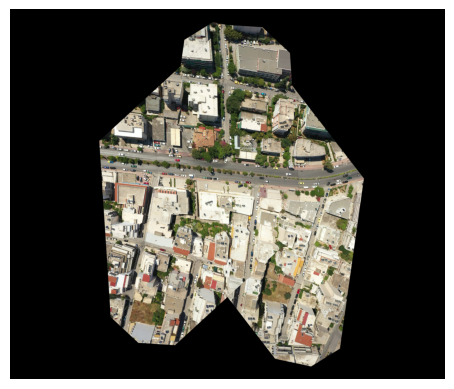

In [43]:
# image_path0 = general_folder_path + 'anchor_test.jpg'
if not start:
    image_path0  = general_folder_path + 'warped_image.jpg'

image0 = load_image(image_path0)

image_path1  = general_folder_path + 'images_distance/6318.jpg'

image1 = load_image(image_path1)

# Determine best rotation angle
rotation_angles = range(0, 360, 45)
best_score, best_angle = -1, 0

for angle in rotation_angles:
    rotated_image1 = rotate_image(image1, angle)
    score = compute_similarity_score(image0, rotated_image1, extractor, matcher)
    if score > best_score:
        best_score, best_angle = score, angle
        best_rotated_image = rotated_image1

# Prepare images for final stitching
imocv0 = cv.imread(image_path0)
imocv1 = cv.cvtColor(np.array(TF.to_pil_image(best_rotated_image.cpu()).convert("RGB")), cv.COLOR_RGB2BGR)

# Extract keypoints and compute homography matrix
feats0, feats1, matches01 = match_pair(extractor, matcher, image0, best_rotated_image)
points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

if points0.shape[0] >= 4:
    M, _ = cv.findHomography(points1, points0, cv.RANSAC, 5.0)
    M_normalized = M / M[2, 2]

    # Extract the rotation and translation components
    M = np.array([
        [M_normalized[0, 0], M_normalized[0, 1], M_normalized[0, 2]],
        [M_normalized[1, 0], M_normalized[1, 1], M_normalized[1, 2]],
        [0,                 0,                 1]
    ])

    dst_padded, warped_image, anchorX, anchorY, sign = warp_perspective_padded1(imocv1, imocv0, M)

    # Define source corners as a numpy array and convert to float32
    new_image_corners = np.array([[0, 0], [imocv1.shape[1], 0],
                                  [imocv1.shape[1], imocv1.shape[0]],
                                  [0, imocv1.shape[0]]], dtype=np.float32)

    # Perform perspective transform with correctly typed data
    transformed_corners = cv.perspectiveTransform(np.array([new_image_corners], dtype=np.float32), M)[0]

    # Update image_corners_df
    adjusted_corners = transformed_corners + [anchorX, anchorY]
    new_row = pd.DataFrame({
        'image_path': [image_path1],
        'corners': [adjusted_corners],
        'frame_number': [os.path.splitext(os.path.basename(image_path1))[0]]
    })
    image_corners_df = pd.concat([image_corners_df, new_row], ignore_index=True)

    if start:
        idx0 = image_corners_df[image_corners_df['image_path'] == image_path0].index[0]
        image_corners_df.at[idx0, 'corners'] += [anchorX, anchorY]
        (anchorX, anchorY) = (0, 0)

    # Overlay warped image onto padded destination
    non_zero_mask = (warped_image > 0).astype(np.uint8)
    dst_padded[non_zero_mask == 1] = warped_image[non_zero_mask == 1]

    # Get last and before last keys
    last_key = image_corners_df['image_path'].iloc[-1]
    warped_image_corners = image_corners_df.loc[image_corners_df['image_path'] == last_key, 'corners'].values[0]
    x_coords, y_coords = warped_image_corners[:, 0], warped_image_corners[:, 1]

    # Define source corners as a numpy array of four points
    corners = np.array([[x_coords[0], y_coords[0]],
                        [x_coords[1], y_coords[1]],
                        [x_coords[2], y_coords[2]],
                        [x_coords[3], y_coords[3]]], dtype=np.float32)

    x_min, y_min = np.min(corners, axis=0).astype(int)
    x_max, y_max = np.max(corners, axis=0).astype(int)

    before_last_key = image_corners_df['image_path'].iloc[-2]
    warped_image_corners = image_corners_df.loc[image_corners_df['image_path'] == before_last_key, 'corners'].values[0]
    x_coords, y_coords = warped_image_corners[:, 0], warped_image_corners[:, 1]

    # Define source corners as a numpy array of four points
    corners = np.array([[x_coords[0], y_coords[0]],
                        [x_coords[1], y_coords[1]],
                        [x_coords[2], y_coords[2]],
                        [x_coords[3], y_coords[3]]], dtype=np.float32)

    b_x_min, b_y_min = np.min(corners, axis=0).astype(int)
    b_x_max, b_y_max = np.max(corners, axis=0).astype(int)

    # Adjust existing image corners in the final panorama
    for img_path in image_corners_df['image_path']:
        if img_path != image_path1:
            idx = image_corners_df[image_corners_df['image_path'] == img_path].index[0]
            image_corners_df.at[idx, 'corners'] += [anchorX, anchorY]

    image_corners_0 = image_corners_df.loc[image_corners_df['image_path'] == before_last_key, 'corners'].values[0]
    image_corners_1 = image_corners_df.loc[image_corners_df['image_path'] == last_key, 'corners'].values[0]

    # Crop the region of interest
    warped_image = warped_image[y_min:y_max, x_min:x_max]
    cv.imwrite(general_folder_path + 'warped_image.jpg', warped_image)

    # Save final images
    cv.imwrite(general_folder_path + 'panorama.jpg', dst_padded)
else:
    print("Not enough points to compute homography.")

plt.imshow(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB))
plt.axis('off')
plt.show()


In [44]:
if start:
    cv.imwrite(general_folder_path+'aligned_image.jpg', cv.imread(general_folder_path+'panorama.jpg'))


anchorX: 761, anchorY: 6
b_x_min: 531, b_y_min: 0


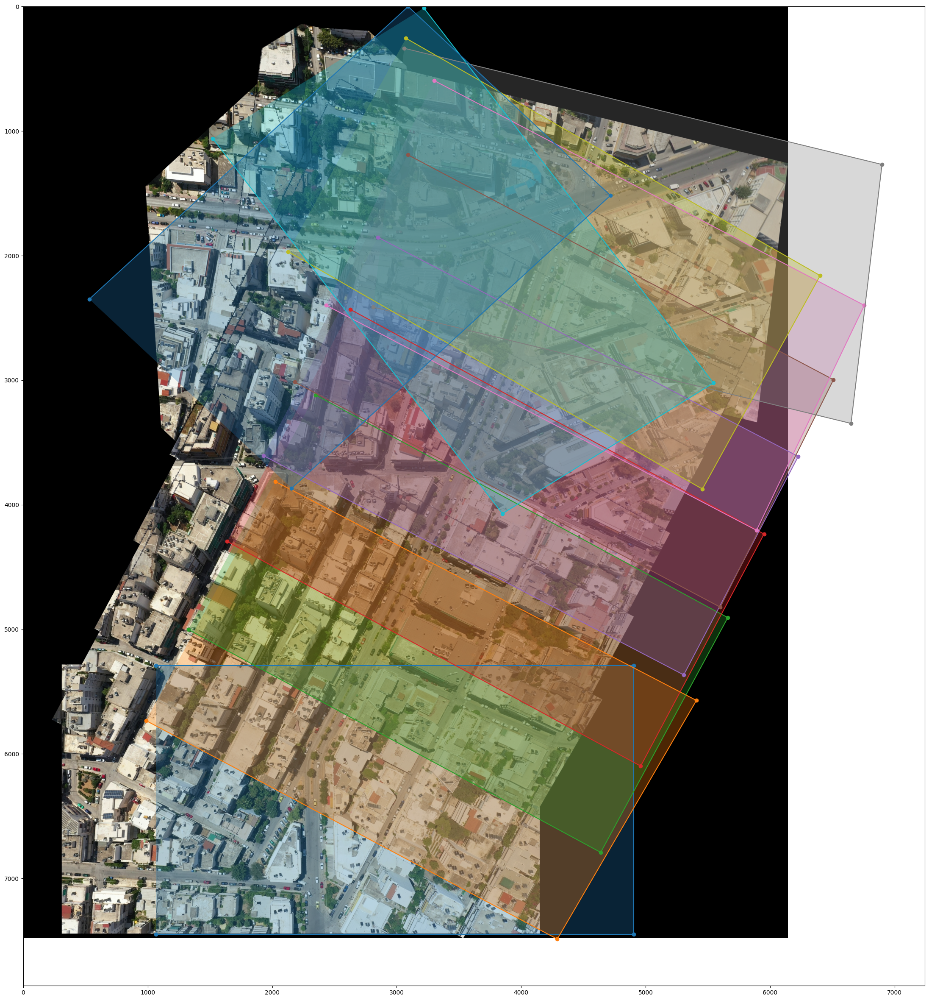

                                           image_path  \
0   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
1   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
2   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
3   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
4   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
5   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
6   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
7   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
8   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
9   /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   
10  /home/oussama/Documents/EPFL/PDS_LUTS/images_d...   

                                              corners frame_number  
0   [[1065, 5291], [4904, 5291], [4904, 7450], [10...         4503  
1   [[2024, 3813], [5408, 5571], [4290, 7487], [98...         4733  
2   [[2347, 3118], [5660, 4906], [4639, 6791], [13...         4891  
3   [[2628, 2432], [5951, 4235], [4960,

In [45]:
# Load the images
current_panorama = cv.imread(general_folder_path + 'panorama.jpg')
new_image = cv.imread(general_folder_path + 'aligned_image.jpg')

# Update image_corners for image_path1
idx1 = image_corners_df[image_corners_df['image_path'] == image_path1].index[0]
image_corners_df.at[idx1, 'corners'] = transformed_corners + [b_x_min+anchorX, b_y_min+anchorY]
image_corners_df.at[idx1, 'corners'] = image_corners_df.at[idx1, 'corners'].astype(np.int32)
print(f"anchorX: {anchorX}, anchorY: {anchorY}")
print(f"b_x_min: {b_x_min}, b_y_min: {b_y_min}")

# Create a 3x3 translation matrix
translation_matrix = np.float32([
    [1, 0, b_x_min - anchorX],
    [0, 1, b_y_min - anchorY],
    [0, 0, 1]
])



if start:
    # Create a 3x3 translation matrix Identity matrix
    translation_matrix = np.float32([
        [1, 0, 0],
        [0, 1, 0],
        [0, 0, 1]
    ])
    start = False

# Apply the translation to the images
dst_padded, warped_image, anchorX, anchorY, _ = warp_perspective_padded1(current_panorama, new_image, translation_matrix)

if not start:
    # Adjust existing image corners in the final panorama
    for img_path in image_corners_df['image_path']:
        if img_path != image_path1:
            idx = image_corners_df[image_corners_df['image_path'] == img_path].index[0]
            image_corners_df.at[idx, 'corners'] += [anchorX, anchorY]

# Create a mask where dst_padded has zero pixels
mask_dst = cv.cvtColor(dst_padded, cv.COLOR_BGR2GRAY)
mask_dst = (mask_dst == 0).astype(np.uint8)

# Ensure mask has three channels
mask_dst_3ch = cv.merge([mask_dst, mask_dst, mask_dst])

# Combine images by filling zeros in dst_padded with pixels from warped_image
combined_image = dst_padded.copy()
combined_image[mask_dst_3ch == 1] = warped_image[mask_dst_3ch == 1]

# Save the combined image
cv.imwrite(general_folder_path + 'aligned_image.jpg', combined_image)

plt.figure(figsize=(40, 30))
# Update and display the panorama with corner points
plt.imshow(cv.cvtColor(combined_image, cv.COLOR_BGR2RGB))
for idx, row in image_corners_df.iterrows():
    corners = row['corners']
    x_coords, y_coords = corners[:, 0], corners[:, 1]
    plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(row['image_path']))
    plt.fill(x_coords, y_coords, alpha=0.3)
plt.axis('on')
# plt.legend()  # Uncomment if you want to add a legend
plt.show()
print(image_corners_df)


In [47]:
print(f"anchorX: {anchorX}, anchorY: {anchorY}")
print(f"b_x_min: {b_x_min}, b_y_min: {b_y_min}")

anchorX: 230, anchorY: 6
b_x_min: 531, b_y_min: 0


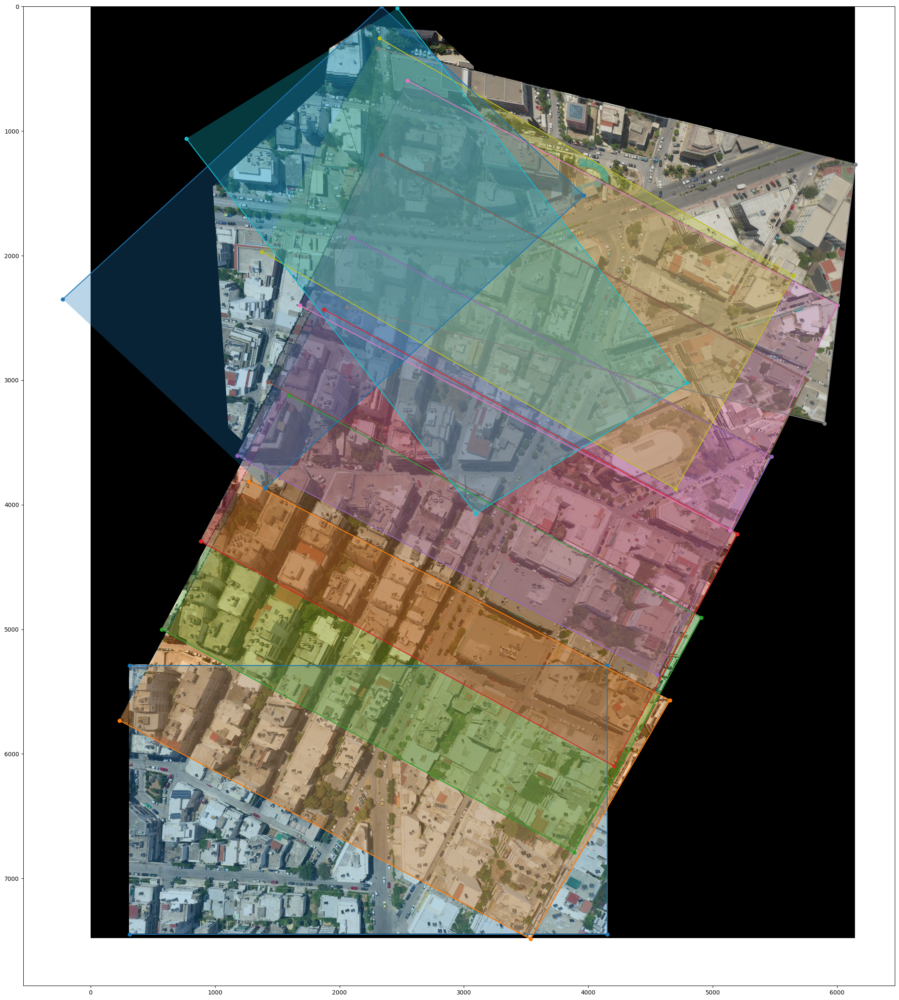

In [52]:
plt.figure(figsize=(40, 30))
# Update and display the panorama with corner points
plt.imshow(cv.cvtColor(combined_image, cv.COLOR_BGR2RGB))
for img_path in image_corners_df['image_path']:
    idx = image_corners_df[image_corners_df['image_path'] == img_path].index[0]
    image_corners_df.at[idx, 'corners'] += [-4, 0]
for idx, row in image_corners_df.iterrows():
    corners = row['corners']
    x_coords, y_coords = corners[:, 0], corners[:, 1]
    plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(row['image_path']))
    plt.fill(x_coords, y_coords, alpha=0.3)
plt.axis('on')
# plt.legend()  # Uncomment if you want to add a legend
plt.show()

In [4]:
import os
import cv2
import numpy as np
import torch
import pandas as pd
import glob
import matplotlib.pyplot as plt

from lightglue import LightGlue, DoGHardNet
from lightglue.utils import load_image, match_pair
import torchvision.transforms.functional as TF

general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'
output_path = general_folder_path + 'panorama.jpg'

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.cuda.empty_cache()

# Utility functions
def rotate_image(image, angle):
    return TF.rotate(image, angle)

def compute_similarity_score(image1, image2, extractor, matcher):
    with torch.no_grad():
        feats0 = extractor.extract(image1)
        feats1 = extractor.extract(image2)
        feats0, feats1, matches01 = match_pair(extractor, matcher, image1, image2)
    points0 = feats0['keypoints'][matches01['matches'][..., 0]]
    score = points0.shape[0]
    del feats0, feats1, matches01, points0
    torch.cuda.empty_cache()
    return score

def warp_perspective_padded1(src, dst, transf):
    src_h, src_w = src.shape[:2]
    dst_h, dst_w = dst.shape[:2]

    src_corners = np.array([[0,0],[src_w,0],[src_w,src_h],[0,src_h]], dtype=np.float32)
    src_corners_transformed = cv2.perspectiveTransform(src_corners[None,:,:], transf)[0]

    dst_corners = np.array([[0,0],[dst_w,0],[dst_w,dst_h],[0,dst_h]], dtype=np.float32)
    all_corners = np.vstack((src_corners_transformed, dst_corners))

    x_min, y_min = np.int32(all_corners.min(axis=0))
    x_max, y_max = np.int32(all_corners.max(axis=0))

    shift_x = -x_min
    shift_y = -y_min

    output_width = x_max - x_min
    output_height = y_max - y_min

    translation_matrix = np.array([
        [1,0,shift_x],
        [0,1,shift_y],
        [0,0,1]
    ], dtype=np.float32)

    new_transf = translation_matrix @ transf
    warped = cv2.warpPerspective(src, new_transf, (output_width, output_height))
    dst_pad = cv2.warpAffine(dst, translation_matrix[:2], (output_width, output_height))

    anchorX = int(shift_x)
    anchorY = int(shift_y)
    sign = (anchorX != 0 or anchorY != 0)
    return dst_pad, warped, anchorX, anchorY, sign

def shift_all_corners(df, dx, dy):
    # Apply a global shift to all corners stored in the DataFrame
    for idx in df.index:
        df.at[idx, 'corners'] = df.at[idx, 'corners'] + [dx, dy]

# Initialize the extractor and matcher on GPU
extractor = DoGHardNet(max_num_keypoints=None).eval().to(device)
matcher = LightGlue(features='doghardnet').eval().to(device)

# Load the first image
image_path0 = os.path.join(general_folder_path, 'images_updated_3840x2160/4503.jpg')
cv2.imwrite(general_folder_path+'warped_image.jpg', cv2.imread(image_path0))

image0 = load_image(image_path0)
first_image_corners = np.array([
    [0, 0],
    [image0.shape[2]-1, 0],
    [image0.shape[2]-1, image0.shape[1]-1],
    [0, image0.shape[1]-1]
], dtype=np.int32)

frame_number = os.path.splitext(os.path.basename(image_path0))[0]

image_corners_df = pd.DataFrame(columns=['image_path', 'corners', 'frame_number'])
new_row = pd.DataFrame({
    'image_path': [image_path0],
    'corners': [first_image_corners],
    'frame_number': [frame_number]
})
image_corners_df = pd.concat([image_corners_df, new_row], ignore_index=True)

# Prepare the folder and images list
image_folder = os.path.join(general_folder_path, 'images_updated_3840x2160')
image_paths = glob.glob(os.path.join(image_folder, '*.jpg'))
image_paths.sort()

# Variables to track global shifts
anchorX, anchorY = 0, 0
start = True

for idx in range(28, 31):
    if not start:
        image_path0 = general_folder_path + 'warped_image.jpg'
    image0 = load_image(image_path0)

    image_path1 = image_paths[idx]
    image1 = load_image(image_path1)

    # Determine best rotation angle
    rotation_angles = range(0, 360, 45)
    best_score, best_angle = -1, 0
    best_rotated_image = None

    for angle in rotation_angles:
        rotated_image1 = rotate_image(image1, angle).to(device)
        score = compute_similarity_score(image0.to(device), rotated_image1, extractor, matcher)
        if score > best_score:
            best_score = score
            best_angle = angle
            best_rotated_image = rotated_image1
        del rotated_image1
        torch.cuda.empty_cache()

    # Convert best_rotated_image back to CPU for OpenCV
    best_rotated_image_cpu = TF.to_pil_image(best_rotated_image.cpu()).convert("RGB")
    imocv0 = cv2.imread(image_path0)
    imocv1 = cv2.cvtColor(np.array(best_rotated_image_cpu), cv2.COLOR_RGB2BGR)

    feats0, feats1, matches01 = match_pair(extractor, matcher, image0.to(device), best_rotated_image.to(device))
    points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
    points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

    del feats0, feats1, matches01
    torch.cuda.empty_cache()

    if points0.shape[0] >= 4:
        M, _ = cv2.findHomography(points1, points0, cv2.RANSAC, 5.0)
        if M is None:
            print("Homography failed for", image_path1)
            continue
        M_normalized = M / M[2, 2]
        M = np.array([
            [M_normalized[0, 0], M_normalized[0, 1], M_normalized[0, 2]],
            [M_normalized[1, 0], M_normalized[1, 1], M_normalized[1, 2]],
            [0,                 0,                 1]
        ])

        dst_padded, warped_image, shift_x, shift_y, sign = warp_perspective_padded1(imocv1, imocv0, M)

        new_image_corners = np.array([
            [0,0],
            [imocv1.shape[1],0],
            [imocv1.shape[1],imocv1.shape[0]],
            [0,imocv1.shape[0]]
        ], dtype=np.float32)

        transformed_corners = cv2.perspectiveTransform(np.array([new_image_corners], dtype=np.float32), M)[0]

        # Now we use b_x_min, b_y_min from the before-last image to decide if we need additional shifts
        if len(image_corners_df) >= 2:
            before_last_idx = len(image_corners_df)-2
        else:
            before_last_idx = 0

        before_last_corners = image_corners_df.iloc[before_last_idx]['corners']
        b_x_min = np.min(before_last_corners[:,0])
        b_y_min = np.min(before_last_corners[:,1])

        x_min_current = np.min(transformed_corners[:,0])
        y_min_current = np.min(transformed_corners[:,1])

        # Decide if global shift is needed based on before-last image's minima
        shift_needed = False
        dx, dy = 0, 0
        if x_min_current < b_x_min:
            dx = b_x_min - x_min_current
            shift_needed = True
        if y_min_current < b_y_min:
            dy = b_y_min - y_min_current
            shift_needed = True

        if shift_needed:
            # Update global anchor shifts
            anchorX += dx
            anchorY += dy

            # Shift all previously stored corners
            shift_all_corners(image_corners_df, dx, dy)

            # Shift the transformed corners of the new image
            transformed_corners += [dx, dy]

        # Now add the new image's corners
        new_row = pd.DataFrame({
            'image_path': [image_path1],
            'corners': [transformed_corners],
            'frame_number': [os.path.splitext(os.path.basename(image_path1))[0]]
        })
        image_corners_df = pd.concat([image_corners_df, new_row], ignore_index=True)

        if start:
            idx0 = image_corners_df[image_corners_df['image_path'] == image_path0].index[0]
            # Apply initial shift if needed
            image_corners_df.at[idx0, 'corners'] += [shift_x, shift_y]
            (anchorX, anchorY) = (0,0)
            start = False

        # Overlay warped image onto padded destination
        non_zero_mask = (warped_image > 0).astype(np.uint8)
        dst_padded[non_zero_mask == 1] = warped_image[non_zero_mask == 1]

        # Update last and before-last keys
        last_key = image_corners_df['image_path'].iloc[-1]
        warped_image_corners = image_corners_df.loc[image_corners_df['image_path'] == last_key, 'corners'].values[0]
        x_coords, y_coords = warped_image_corners[:,0], warped_image_corners[:,1]
        x_min, y_min = np.min(x_coords), np.min(y_coords)
        x_max, y_max = np.max(x_coords), np.max(y_coords)

        before_last_key = image_corners_df['image_path'].iloc[-2]
        warped_image_corners = image_corners_df.loc[image_corners_df['image_path'] == before_last_key, 'corners'].values[0]
        x_coords, y_coords = warped_image_corners[:,0], warped_image_corners[:,1]
        b_x_min, b_y_min = np.min(x_coords), np.min(y_coords)
        b_x_max, b_y_max = np.max(x_coords), np.max(y_coords)

        # Crop the region of interest
        warped_image = warped_image[int(y_min):int(y_max), int(x_min):int(x_max)]
        cv2.imwrite(general_folder_path + 'warped_image.jpg', warped_image)

        # Save final images
        cv2.imwrite(general_folder_path + 'panorama.jpg', dst_padded)

    else:
        print("Not enough points to compute homography for", image_path1)
        continue

    current_panorama = cv2.imread(general_folder_path + 'panorama.jpg')
    new_image = cv2.imread(general_folder_path + 'aligned_image.jpg') if os.path.exists(general_folder_path+'aligned_image.jpg') else current_panorama.copy()

    # Update image_corners for image_path1 based on b_x_min, b_y_min and anchor
    idx1 = image_corners_df[image_corners_df['image_path'] == image_path1].index[0]
    image_corners_df.at[idx1, 'corners'] = transformed_corners + [b_x_min+anchorX, b_y_min+anchorY]
    image_corners_df.at[idx1, 'corners'] = image_corners_df.at[idx1, 'corners'].astype(np.int32)

    # Create a 3x3 translation matrix
    translation_matrix = np.float32([
        [1,0,b_x_min - anchorX],
        [0,1,b_y_min - anchorY],
        [0,0,1]
    ])

    if not os.path.exists(general_folder_path+'aligned_image.jpg'):
        # If first time
        translation_matrix = np.float32([[1,0,0],[0,1,0],[0,0,1]])

    dst_padded, warped_image, shift_x, shift_y, _ = warp_perspective_padded1(current_panorama, new_image, translation_matrix)

    mask_dst = cv2.cvtColor(dst_padded, cv2.COLOR_BGR2GRAY)
    mask_dst = (mask_dst == 0).astype(np.uint8)
    mask_dst_3ch = cv2.merge([mask_dst, mask_dst, mask_dst])

    combined_image = dst_padded.copy()
    combined_image[mask_dst_3ch == 1] = warped_image[mask_dst_3ch == 1]

    cv2.imwrite(general_folder_path + 'aligned_image.jpg', combined_image)

cv2.imwrite(general_folder_path + 'final_panorama.jpg', combined_image)

plt.figure(figsize=(40,30))
plt.imshow(cv2.cvtColor(combined_image, cv2.COLOR_BGR2RGB))
for idx, row in image_corners_df.iterrows():
    corners = row['corners']
    x_coords, y_coords = corners[:,0], corners[:,1]
    plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(row['image_path']))
    plt.fill(x_coords, y_coords, alpha=0.3)
plt.axis('on')
plt.show()

image_corners_df.to_csv(general_folder_path + 'results/image_corners.csv', index=False)
torch.cuda.empty_cache()


error: OpenCV(4.10.0) /io/opencv/modules/imgcodecs/src/loadsave.cpp:798: error: (-215:Assertion failed) !_img.empty() in function 'imwrite'


NameError: name 'image_corners' is not defined

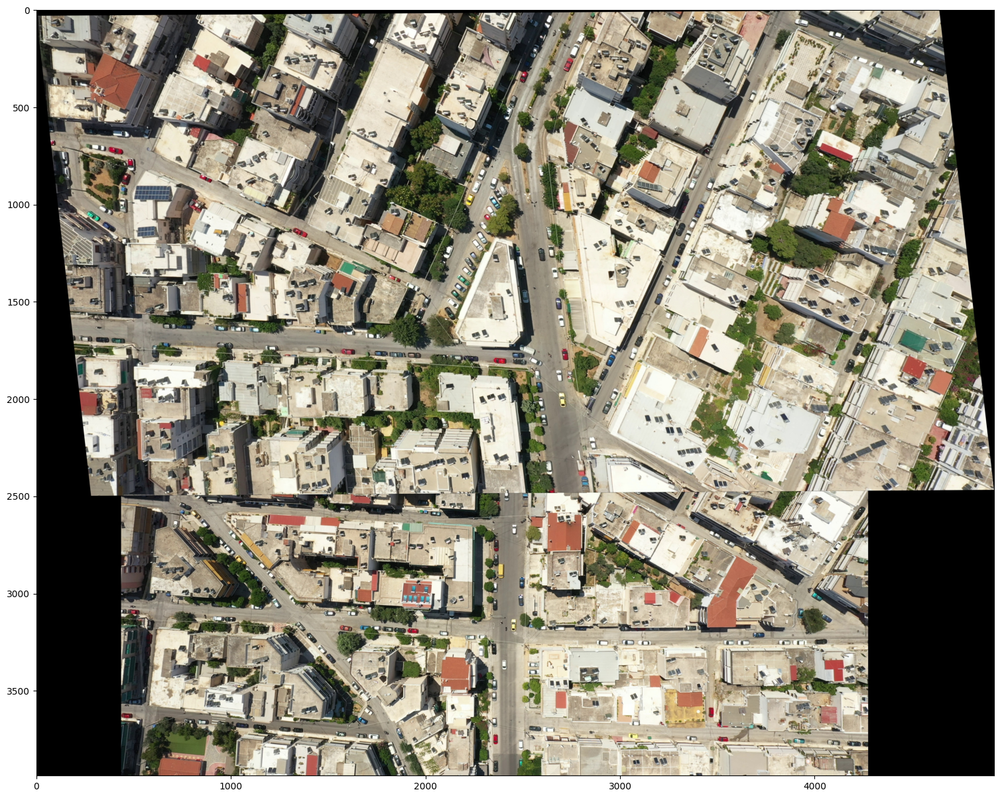

In [10]:
plt.figure(figsize=(20, 15))
plt.imshow(cv.cvtColor(combined_image, cv.COLOR_BGR2RGB))
for img_path, corners in image_corners.items():
    x_coords, y_coords = corners[:, 0], corners[:, 1]
    plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(img_path))
    plt.fill(x_coords, y_coords, alpha=0.3)
plt.axis('on')
# plt.legend()  # Add legend to identify images
plt.savefig(general_folder_path + 'results/panorama_plot_only_rotation_translation_homography.png', bbox_inches='tight', pad_inches=0)
plt.show()

In [8]:
# Save the df to a csv file
image_corners_df.to_csv(general_folder_path + 'results/image_corners.csv', index=False)

: 

In [ ]:
image_path0 = general_folder_path + "batch_2.jpg"
image0 = load_image(image_path0)

image_path1  = general_folder_path + 'batch_3.jpg'

image1 = load_image(image_path1)

# Feature extractor and matcher initialization
extractor = DoGHardNet(max_num_keypoints=None).eval().cuda()
matcher = LightGlue(features='doghardnet').eval().cuda()

# Determine best rotation angle
rotation_angles = range(0, 360, 15)
best_score, best_angle = -1, 0

for angle in rotation_angles:
    rotated_image1 = rotate_image(image1, angle)
    score = compute_similarity_score(image0, rotated_image1, extractor, matcher)
    if score > best_score:
        best_score, best_angle = score, angle
        best_rotated_image = rotated_image1

# Prepare images for final stitching
imocv0 = cv.imread(image_path0)
imocv1 = cv.cvtColor(np.array(TF.to_pil_image(best_rotated_image.cpu()).convert("RGB")), cv.COLOR_RGB2BGR)

# Extract keypoints and compute homography matrix
feats0, feats1, matches01 = match_pair(extractor, matcher, image0, best_rotated_image)
points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

if points0.shape[0] >= 4:
    M, _ = cv.findHomography(points1, points0, cv.RANSAC, 5.0)
    dst_padded, warped_image, anchorX, anchorY = warp_perspective_padded1(imocv1, imocv0, M)

    # Overlay warped image onto padded destination
    non_zero_mask = (warped_image > 0).astype(np.uint8)
    dst_padded[non_zero_mask == 1] = warped_image[non_zero_mask == 1]

    # Update and display the panorama with corner points
    plt.imshow(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    # Save final images
    cv.imwrite(general_folder_path + 'panorama.jpg', dst_padded)
else:
    print("Not enough points to compute homography.")

Stitching Images:   0%|          | 0/9 [00:00<?, ?it/s]

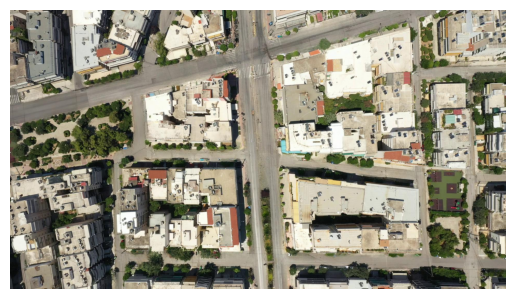

Stitching Images:  11%|█         | 1/9 [00:10<01:22, 10.28s/it]

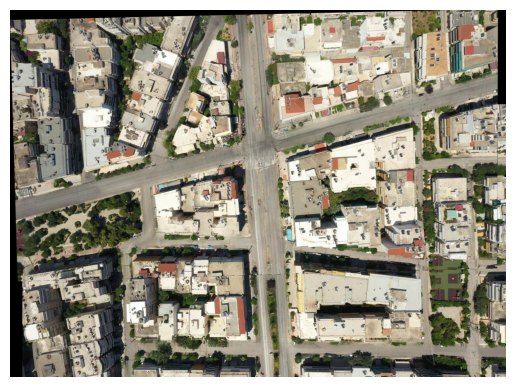

Stitching Images:  22%|██▏       | 2/9 [00:20<01:12, 10.42s/it]

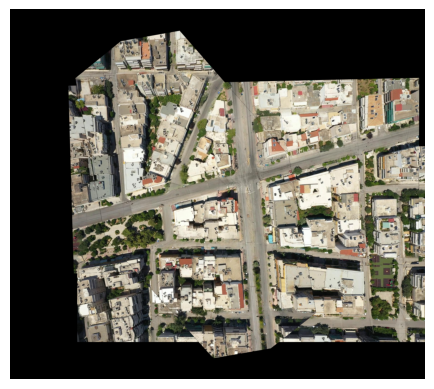

Stitching Images:  33%|███▎      | 3/9 [00:33<01:09, 11.51s/it]

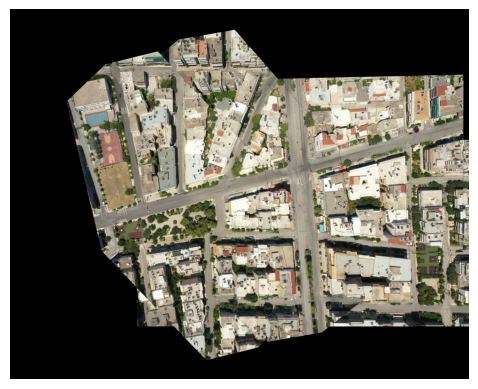

Stitching Images:  44%|████▍     | 4/9 [00:45<00:58, 11.73s/it]

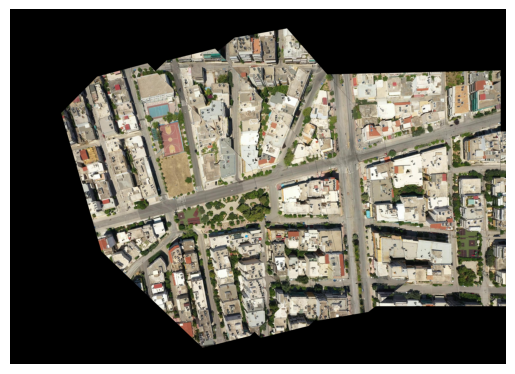

Stitching Images:  56%|█████▌    | 5/9 [00:57<00:46, 11.61s/it]

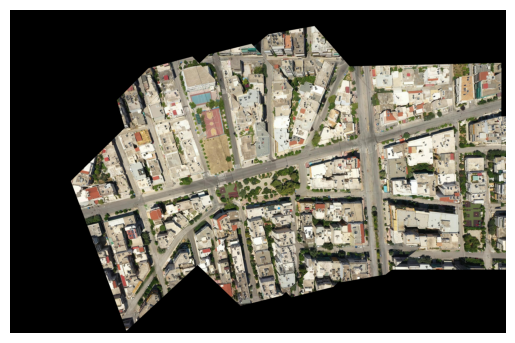

Stitching Images:  67%|██████▋   | 6/9 [01:07<00:33, 11.15s/it]

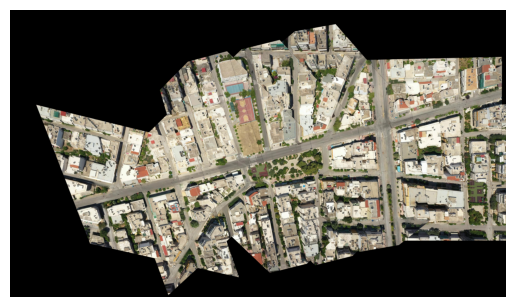

Stitching Images:  78%|███████▊  | 7/9 [01:16<00:21, 10.62s/it]

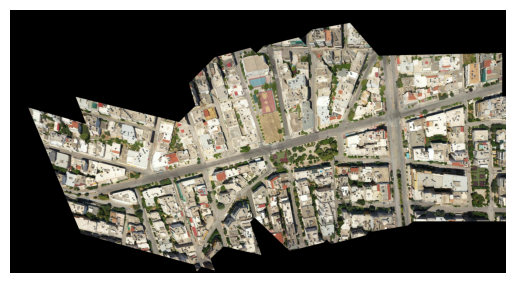

Stitching Images:  89%|████████▉ | 8/9 [01:25<00:10, 10.07s/it]

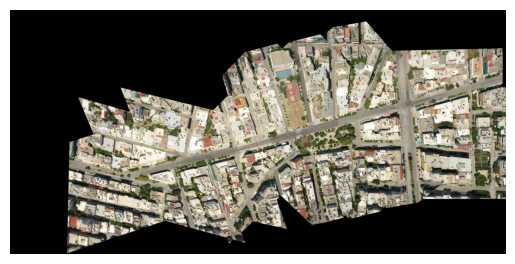

Stitching Images: 100%|██████████| 9/9 [01:34<00:00, 10.49s/it]


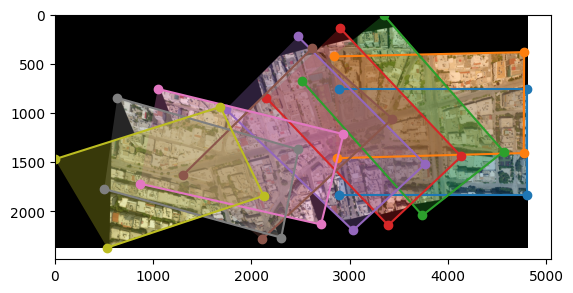

In [ ]:
import os
import cv2 as cv
import numpy as np
import torch
import torchvision.transforms as T
from matplotlib import pyplot as plt
from tqdm import tqdm  # Import tqdm for progress bar

# Set general paths
output_path = general_folder_path + 'panorama.jpg'
torch.cuda.empty_cache()

# Define transformations to handle conversions between NumPy arrays and PyTorch tensors
to_tensor = T.ToTensor()
to_pil = T.ToPILImage()

# Utility function definitions (as provided previously)
images_path = general_folder_path + 'images_updated_1920x1080/'
# Load all images in the folder
image_files = sorted([f for f in os.listdir(images_path) if f.endswith('.jpg')])
image_paths = [os.path.join(images_path, f) for f in image_files]

# Initialize dictionary for image corners and set up the first image as the initial panorama
image_corners = {}

# Load the first image and set as the initial panorama in dst_padded
first_image_path = image_paths[15]
dst_padded = cv.imread(first_image_path)  # Keep as BGR
image_corners[first_image_path] = np.array([[0, 0], [dst_padded.shape[1] - 1, 0],
                                            [dst_padded.shape[1] - 1, dst_padded.shape[0] - 1],
                                            [0, dst_padded.shape[0] - 1]])

# Convert dst_padded to PyTorch tensor with batch dimension for feature extraction
dst_padded_tensor = to_tensor(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB)).unsqueeze(0).cuda()  # Convert to RGB for PyTorch

# Loop through each subsequent image in the folder with a progress bar
for i in tqdm(range(15, 24), desc="Stitching Images"):
    current_image_path = image_paths[i]
    current_image = cv.imread(current_image_path)  # Keep as BGR

    # Convert current image to tensor with batch dimension for feature extraction
    current_image_tensor = to_tensor(cv.cvtColor(current_image, cv.COLOR_BGR2RGB)).unsqueeze(0).cuda()  # Convert to RGB for PyTorch

    # Determine the best rotation angle for alignment
    best_score, best_angle = -1, 0
    for angle in range(0, 360, 30):
        rotated_image = rotate_image(current_image_tensor, angle)
        score = compute_similarity_score(dst_padded_tensor, rotated_image, extractor, matcher)
        if score > best_score:
            best_score, best_angle = score, angle
            best_rotated_image = rotated_image

    # Convert best rotated image back to NumPy BGR format for OpenCV processing
    imocv_current = cv.cvtColor(np.array(to_pil(best_rotated_image.squeeze(0).cpu())), cv.COLOR_RGB2BGR)

    # Extract keypoints and compute homography matrix
    feats0, feats1, matches01 = match_pair(extractor, matcher, dst_padded_tensor, best_rotated_image)
    points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
    points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

    if points0.shape[0] >= 4:
        # Compute homography and warp the current image
        M, _ = cv.findHomography(points1, points0, cv.RANSAC, 5.0)
        dst_padded, warped_image, anchorX, anchorY = warp_perspective_padded(imocv_current, dst_padded, M)

        # Update corners for the current image
        new_image_corners = np.array([[0, 0], [imocv_current.shape[1], 0],
                                      [imocv_current.shape[1], imocv_current.shape[0]],
                                      [0, imocv_current.shape[0]]], dtype=np.float32)
        transformed_corners = cv.perspectiveTransform(np.array([new_image_corners], dtype=np.float32), M)[0]
        image_corners[current_image_path] = transformed_corners + [anchorX, anchorY]

        # Adjust all existing image corners
        for img_path, corners in image_corners.items():
            if img_path != current_image_path:
                image_corners[img_path] += [anchorX, anchorY]

        # Overlay warped image onto padded destination
        non_zero_mask = (warped_image > 0).astype(np.uint8)
        dst_padded[non_zero_mask == 1] = warped_image[non_zero_mask == 1]

        plt.imshow(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB)) 
        plt.axis('off')
        plt.show()

        # Update dst_padded_tensor to reflect the updated panorama for the next iteration
        dst_padded_tensor = to_tensor(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB)).unsqueeze(0).cuda()

    else:
        print(f"Not enough points to compute homography for {current_image_path}.")

# Save the final panorama
cv.imwrite(output_path, dst_padded)  # dst_padded is already in BGR format

# Display final panorama with corners
plt.imshow(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB))  # Convert to RGB for visualization
plt.axis('on')
for img_path, corners in image_corners.items():
    x_coords, y_coords = corners[:, 0], corners[:, 1]
    plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(img_path))
    plt.fill(x_coords, y_coords, alpha=0.3)
plt.show()


In [ ]:
from lightglue import LightGlue, SuperPoint, viz2d, DISK, SIFT, ALIKED, DoGHardNet
from lightglue.utils import load_image, rbd, match_pair
import os
import cv2 as cv
import numpy as np
import torch
import torchvision.transforms as T
from matplotlib import pyplot as plt
from tqdm import tqdm


# Utility Functions
def load_image(image_path):
    """Load an image and return it in BGR format."""
    return cv.imread(image_path)


def convert_to_tensor(image_bgr):
    """Convert a BGR image to RGB and then to a PyTorch tensor."""
    image_rgb = cv.cvtColor(image_bgr, cv.COLOR_BGR2RGB)
    return T.ToTensor()(image_rgb).unsqueeze(0).cuda()

def initialize_panorama(image_paths, index):
    """
    Initialize the panorama with the first image.
    
    Args:
        image_paths (list): List of image paths.
        index (int): Index of the image to initialize with.
    
    Returns:
        tuple: Initial padded panorama (BGR format), its tensor (RGB format), and the corners.
    """
    first_image_path = image_paths[index]
    first_image = load_image(first_image_path)  # Load as BGR
    corners = np.array([[0, 0], 
                        [first_image.shape[1] - 1, 0],
                        [first_image.shape[1] - 1, first_image.shape[0] - 1],
                        [0, first_image.shape[0] - 1]], dtype=np.float32)

    # Convert the image to tensor
    first_image_tensor = convert_to_tensor(first_image)

    return first_image, first_image_tensor, corners


def compute_best_rotation(image_tensor, reference_tensor, extractor, matcher, angle_step=30):
    """Find the best rotation for alignment based on a similarity score."""
    best_score, best_angle = -1, 0
    best_rotated_image = None

    for angle in range(0, 360, angle_step):
        rotated_image = rotate_image(image_tensor, angle)
        score = compute_similarity_score(reference_tensor, rotated_image, extractor, matcher)
        if score > best_score:
            best_score, best_angle = score, angle
            best_rotated_image = rotated_image

    return best_angle, best_rotated_image


def warp_and_update(dst_padded, current_image, points0, points1, M):
    """Warp the current image using the homography matrix and update the panorama."""
    dst_padded, warped_image, anchorX, anchorY = warp_perspective_padded(current_image, dst_padded, M)

    # Overlay warped image onto padded destination
    non_zero_mask = (warped_image > 0).astype(np.uint8)
    dst_padded[non_zero_mask == 1] = warped_image[non_zero_mask == 1]

    return dst_padded, anchorX, anchorY


def update_corners(image_corners, current_image_path, transformed_corners, anchorX, anchorY):
    """Update the corners for the current and existing images."""
    # Add new corners for the current image
    image_corners[current_image_path] = transformed_corners + [anchorX, anchorY]

    # Adjust all existing image corners
    for img_path, corners in image_corners.items():
        if img_path != current_image_path:
            image_corners[img_path] += [anchorX, anchorY]


def visualize_panorama(dst_padded, image_corners, save_path=None):
    """Display and optionally save the current panorama and corners."""
    plt.imshow(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB))  # Convert to RGB for visualization
    plt.axis('on')
    for img_path, corners in image_corners.items():
        x_coords, y_coords = corners[:, 0], corners[:, 1]
        plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(img_path))
        plt.fill(x_coords, y_coords, alpha=0.3)
    if save_path:
        plt.savefig(save_path)
    plt.show()


# Batch Stitching
def stitch_batch(image_paths, extractor, matcher, batch_index, save_path):
    """Stitch a batch of images and save the result."""
    image_corners = {}

    # Initialize panorama with the first image in the batch
    dst_padded, dst_padded_tensor, initial_corners = initialize_panorama(image_paths, 0)
    image_corners[image_paths[0]] = initial_corners

    # Loop through the rest of the images in the batch
    for i in range(1, len(image_paths)):
        current_image_path = image_paths[i]
        current_image = load_image(current_image_path)  # BGR

        # Convert to tensor
        current_image_tensor = convert_to_tensor(current_image)

        # Find best rotation
        _, best_rotated_image = compute_best_rotation(current_image_tensor, dst_padded_tensor, extractor, matcher)

        # Convert best rotated image back to NumPy (BGR)
        imocv_current = cv.cvtColor(np.array(T.ToPILImage()(best_rotated_image.squeeze(0).cpu())), cv.COLOR_RGB2BGR)

        # Extract features and compute homography
        feats0, feats1, matches01 = match_pair(extractor, matcher, dst_padded_tensor, best_rotated_image)
        points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
        points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

        if points0.shape[0] >= 4:
            # Compute homography
            M, _ = cv.findHomography(points1, points0, cv.RANSAC, 5.0)

            # Warp current image and update panorama
            dst_padded, anchorX, anchorY = warp_and_update(dst_padded, imocv_current, points0, points1, M)

            # Update corners
            new_image_corners = np.array([[0, 0], [imocv_current.shape[1], 0],
                                          [imocv_current.shape[1], imocv_current.shape[0]],
                                          [0, imocv_current.shape[0]]], dtype=np.float32)
            transformed_corners = cv.perspectiveTransform(np.array([new_image_corners], dtype=np.float32), M)[0]
            update_corners(image_corners, current_image_path, transformed_corners, anchorX, anchorY)

            # Update panorama tensor
            dst_padded_tensor = convert_to_tensor(dst_padded)

        else:
            print(f"Not enough points to compute homography for {current_image_path}.")

    # Save the intermediate panorama for this batch
    intermediate_save_path = os.path.join(save_path, f"batch_{batch_index}.jpg")
    cv.imwrite(intermediate_save_path, dst_padded)
    print(f"Batch {batch_index} panorama saved at {intermediate_save_path}")

    return intermediate_save_path, dst_padded


def batch_stitching(image_paths, extractor, matcher, batch_size, save_path):
    """Perform stitching in overlapping batches."""
    intermediate_results = []

    # Process batches with overlap
    for batch_index in range(0, len(image_paths), batch_size - 1):
        batch_paths = image_paths[batch_index:batch_index + batch_size]

        # Handle case where the last batch has fewer images
        if len(batch_paths) < 2:
            break

        intermediate_result, _ = stitch_batch(batch_paths, extractor, matcher, batch_index // (batch_size - 1), save_path)
        intermediate_results.append(intermediate_result)

    # Stitch intermediate results
    while len(intermediate_results) > 1:
        temp_results = []
        for i in range(0, len(intermediate_results), 2):
            if i + 1 < len(intermediate_results):
                batch_paths = [intermediate_results[i], intermediate_results[i + 1]]
                intermediate_result, _ = stitch_batch(batch_paths, extractor, matcher, f"combined_{i}", save_path)
                temp_results.append(intermediate_result)
            else:
                temp_results.append(intermediate_results[i])
        intermediate_results = temp_results

    # Final panorama
    final_panorama_path = intermediate_results[0]
    print(f"Final panorama saved at {final_panorama_path}")
    return final_panorama_path


# Usage
general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'
output_path = general_folder_path + "final_panorama.jpg"
images_path = general_folder_path + "images_updated_1920x1080/"
image_files = sorted([f for f in os.listdir(images_path) if f.endswith('.jpg')])
image_paths = [os.path.join(images_path, f) for f in image_files]

extractor = DoGHardNet(max_num_keypoints=None).eval().cuda()
matcher = LightGlue(features='doghardnet').eval().cuda()
save_path = os.path.join(general_folder_path, "intermediate_results")
os.makedirs(save_path, exist_ok=True)

final_result = batch_stitching(image_paths, extractor, matcher, batch_size=3, save_path=save_path)


Batch 0 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_0.jpg
Batch 1 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_1.jpg
Batch 2 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_2.jpg
Batch 3 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_3.jpg
Batch 4 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_4.jpg
Batch 5 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_5.jpg
Batch 6 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_6.jpg
Batch 7 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_7.jpg
Batch 8 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_8.jpg
Batch 9 panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/intermediate_results/batch_9.jpg
Batch 10 panorama saved at /ho

OutOfMemoryError: CUDA out of memory. Tried to allocate 1022.00 MiB. GPU 0 has a total capacity of 11.71 GiB of which 373.44 MiB is free. Including non-PyTorch memory, this process has 10.71 GiB memory in use. Of the allocated memory 8.66 GiB is allocated by PyTorch, and 1.85 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
import os
import cv2 as cv
import torchvision.transforms as T
from lightglue import LightGlue, DoGHardNet
from lightglue.utils import match_pair
import torch


# Configure paths
batch_folder_path = general_folder_path + "intermediate_results/"
save_path = general_folder_path + "tree_stitching_results/"
os.makedirs(save_path, exist_ok=True)

# Initialize the feature extractor and matcher
extractor = DoGHardNet(max_num_keypoints=None).eval().cuda()
matcher = LightGlue(features='doghardnet').eval().cuda()


def load_batches(batch_folder_path):
    """Load all batch image paths, sorted by their indices."""
    batch_files = sorted(
        [os.path.join(batch_folder_path, f) for f in os.listdir(batch_folder_path) if f.endswith('.jpg')],
        key=lambda x: int(os.path.splitext(os.path.basename(x))[0].split('_')[-1])
    )
    return batch_files


def rotate_image(image_tensor, angle):
    return TF.rotate(image_tensor, angle)

def compute_best_rotation(tensor1, tensor2, extractor, matcher, angle_step=15):
    """Find the best rotation angle between two images."""
    best_score, best_angle = -1, 0
    best_rotated_image = None

    for angle in range(0, 360, angle_step):
        rotated_image = rotate_image(tensor2, angle)
        feats1, feats2, matches = match_pair(extractor, matcher, tensor1, rotated_image)
        score = len(matches['matches'])  # Use the number of matches as a similarity score

        if score > best_score:
            best_score, best_angle = score, angle
            best_rotated_image = rotated_image

    return best_angle, best_rotated_image


def stitch_two_batches(batch1_path, batch2_path, extractor, matcher, save_path, result_index):
    """Stitch two batches together with rotation checks and save the result."""
    # Load the images
    image1 = cv.imread(batch1_path)
    image2 = cv.imread(batch2_path)

    # Convert images to tensors for LightGlue
    tensor1 = T.ToTensor()(cv.cvtColor(image1, cv.COLOR_BGR2RGB)).unsqueeze(0).cuda()
    tensor2 = T.ToTensor()(cv.cvtColor(image2, cv.COLOR_BGR2RGB)).unsqueeze(0).cuda()

    # Find the best rotation angle and rotated version of the second image
    _, best_rotated_tensor = compute_best_rotation(tensor1, tensor2, extractor, matcher)

    # Convert the best-rotated tensor back to a NumPy array (BGR format)
    best_rotated_image = (
        best_rotated_tensor.squeeze(0).permute(1, 2, 0).cpu().numpy() * 255
    ).astype("uint8")
    best_rotated_image = cv.cvtColor(best_rotated_image, cv.COLOR_RGB2BGR)

    # Extract features and match keypoints using LightGlue
    feats1, feats2, matches = match_pair(extractor, matcher, tensor1, best_rotated_tensor)

    # Get matched keypoints
    points1 = feats1['keypoints'][matches['matches'][..., 0]].cpu().numpy()
    points2 = feats2['keypoints'][matches['matches'][..., 1]].cpu().numpy()

    if points1.shape[0] >= 4:
        # Compute the homography matrix
        M, _ = cv.findHomography(points2, points1, cv.RANSAC, 5.0)

        # Warp the second image into the first
        h1, w1, _ = image1.shape
        h2, w2, _ = best_rotated_image.shape
        panorama_size = (w1 + w2, max(h1, h2))  # Extend width to fit both images
        stitched_image = cv.warpPerspective(best_rotated_image, M, panorama_size)
        stitched_image[0:h1, 0:w1] = image1  # Overlay the first image

        # Save the stitched result
        result_path = os.path.join(save_path, f"stitched_{result_index}.jpg")
        cv.imwrite(result_path, stitched_image)
        print(f"Saved stitched image: {result_path}")
        return result_path
    else:
        print(f"Not enough points to stitch {batch1_path} and {batch2_path}.")
        return None


def tree_stitch_batches(batch_folder_path, extractor, matcher, save_path):
    """Perform tree-like stitching of batches."""
    batch_files = load_batches(batch_folder_path)
    round_index = 0

    while len(batch_files) > 1:
        print(f"Starting round {round_index} with {len(batch_files)} batches.")
        stitched_files = []

        for i in range(0, len(batch_files), 2):
            if i + 1 < len(batch_files):
                # Stitch two batches
                result_path = stitch_two_batches(batch_files[i], batch_files[i + 1], extractor, matcher, save_path, f"{round_index}_{i // 2}")
                if result_path:
                    stitched_files.append(result_path)
            else:
                # If an odd batch remains, carry it to the next round
                print(f"Carrying over: {batch_files[i]}")
                stitched_files.append(batch_files[i])

        # Update the batch files for the next round
        batch_files = stitched_files
        round_index += 1

    if batch_files:
        final_panorama_path = batch_files[0]
        print(f"Final panorama saved at: {final_panorama_path}")
        return final_panorama_path
    else:
        print("No final panorama could be created.")
        return None


# Run the stitching process
final_panorama_path = tree_stitch_batches(batch_folder_path, extractor, matcher, save_path)


Starting round 0 with 19 batches.


OutOfMemoryError: CUDA out of memory. Tried to allocate 910.00 MiB. GPU 0 has a total capacity of 11.71 GiB of which 778.38 MiB is free. Including non-PyTorch memory, this process has 10.32 GiB memory in use. Of the allocated memory 8.42 GiB is allocated by PyTorch, and 1.70 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
from lightglue import LightGlue, SuperPoint, viz2d, DISK, SIFT, ALIKED, DoGHardNet
from lightglue.utils import load_image, rbd, match_pair
import matplotlib.pyplot as plt
import cv2 as cv
import numpy as np
import torch
import torchvision.transforms.functional as TF
import os

general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'

output_path = general_folder_path + 'panorama.jpg'

torch.cuda.empty_cache()

# Utility function to calculate image corners in homogeneous coordinates
def get_homogeneous_corners(width, height):
    return np.array([[0, 0, 1], [width, 0, 1], [width, height, 1], [0, height, 1]]).T

def warp_perspective_padded1(src, transf, dst_shape):
    src_h, src_w = src.shape[:2]
    lin_homg_pts = np.array([[0, src_w, src_w, 0],
                             [0, 0, src_h, src_h],
                             [1, 1, 1, 1]])

    # Transform the source corners
    trans_lin_homg_pts = transf @ lin_homg_pts
    trans_lin_homg_pts /= trans_lin_homg_pts[2, :]

    # Determine transformed bounds
    minX = np.min(trans_lin_homg_pts[0, :])
    minY = np.min(trans_lin_homg_pts[1, :])
    maxX = np.max(trans_lin_homg_pts[0, :])
    maxY = np.max(trans_lin_homg_pts[1, :])

    # Determine padding amounts
    padding_top = max(0, -minY)
    padding_left = max(0, -minX)
    padding_bottom = max(0, maxY - dst_shape[0])
    padding_right = max(0, maxX - dst_shape[1])
    print(f"padding_top: {padding_top}, padding_left: {padding_left}, padding_bottom: {padding_bottom}, padding_right: {padding_right}")

    # Compute new padded size
    pad_sz = [
        dst_shape[0] + int(padding_top) + int(padding_bottom),
        dst_shape[1] + int(padding_left) + int(padding_right),
    ]
    dst_pad = np.zeros((pad_sz[0], pad_sz[1], 3), dtype=np.uint8)

    # Update the transformation matrix to account for the padding
    transl_transf = np.eye(3)
    transl_transf[0, 2] = max(0, -minX)
    transl_transf[1, 2] = max(0, -minY)

    # Combine the translation with the original transformation
    new_transf = transl_transf @ transf
    new_transf /= new_transf[2, 2]

    # Warp the source image into the padded canvas
    warped = cv.warpPerspective(src, new_transf, (pad_sz[1], pad_sz[0]))

    return warped, new_transf, pad_sz

# Rotate image tensor by specified angle
def rotate_image(image, angle):
    return TF.rotate(image, angle)

# Calculate similarity score between two images
def compute_similarity_score(image1, image2, extractor, matcher):
    feats0 = extractor.extract(image1)
    feats1 = extractor.extract(image2)
    feats0, feats1, matches01 = match_pair(extractor, matcher, image1, image2)
    points0 = feats0['keypoints'][matches01['matches'][..., 0]]
    return points0.shape[0]

# Feature extractor and matcher initialization
extractor = DoGHardNet(max_num_keypoints=None).eval().cuda()
matcher = LightGlue(features='doghardnet').eval().cuda()

# Initialize dictionaries for images and their transformations
image_corners = {}
image_transforms = {}

# Start flag
start = True

# Load the initial image
image_path0 = general_folder_path + 'images_updated_1920x1080/3600.jpg'
cv.imwrite(general_folder_path + 'panorama.jpg', cv.imread(image_path0))
image0 = load_image(image_path0)
image_path0 = general_folder_path + 'panorama.jpg'

# Read the initial panorama image
panorama = cv.imread(image_path0)

# Initialize the transformation of the first image (identity)
image_transforms[image_path0] = np.eye(3, dtype=np.float32)

# Initialize the corners of the first image
h, w = panorama.shape[:2]
corners = np.array([[0, 0], [w, 0], [w, h], [0, h]], dtype=np.float32)
image_corners[image_path0] = corners


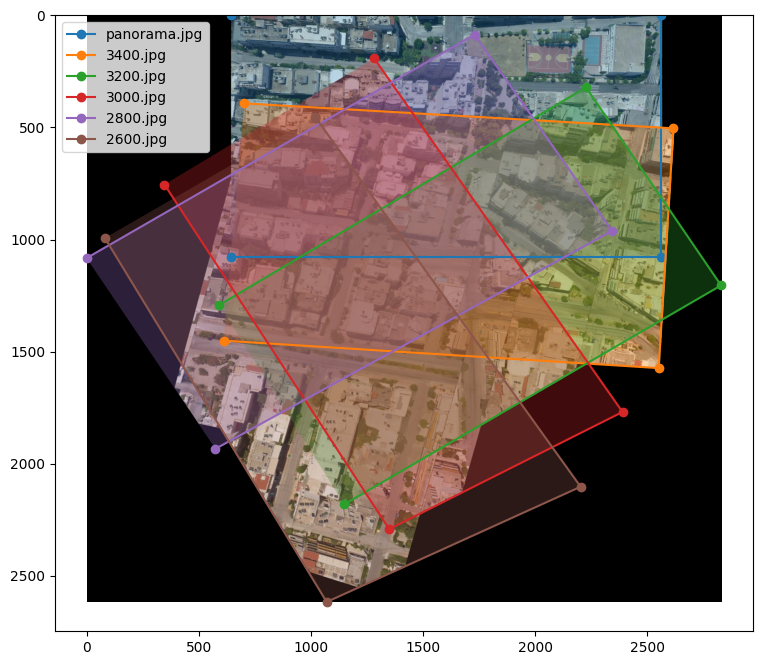

In [ ]:
# Update image_path1 to the next image to be added
image_path1 = general_folder_path + 'images_updated_1920x1080/2600.jpg'  # Change this for each new image
image1 = load_image(image_path1)

# Determine best rotation angle
rotation_angles = range(0, 360, 45)
best_score, best_angle = -1, 0

for angle in rotation_angles:
    rotated_image1 = rotate_image(image1, angle)
    score = compute_similarity_score(image0, rotated_image1, extractor, matcher)
    if score > best_score:
        best_score, best_angle = score, angle
        best_rotated_image = rotated_image1

# Prepare images for final stitching
imocv1 = cv.cvtColor(np.array(TF.to_pil_image(best_rotated_image.cpu()).convert("RGB")), cv.COLOR_RGB2BGR)

# Extract keypoints and compute homography matrix
feats0, feats1, matches01 = match_pair(extractor, matcher, image0, best_rotated_image)
points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

if points0.shape[0] >= 4:
    M, _ = cv.findHomography(points1, points0, cv.RANSAC, 5.0)

    # Compute the transformation matrix for the new image
    image_transforms[image_path1] = M @ image_transforms[image_path0]

    # Compute the transformed corners of the new image
    h1, w1 = imocv1.shape[:2]
    corners1 = np.array([[0, 0], [w1, 0], [w1, h1], [0, h1]], dtype=np.float32)
    transformed_corners1 = cv.perspectiveTransform(corners1.reshape(-1, 1, 2), image_transforms[image_path1]).reshape(-1, 2)

    # Update the corners dictionary
    image_corners[image_path1] = transformed_corners1

    # Compute the global bounding box
    all_corners = np.vstack(list(image_corners.values()))
    [xmin, ymin] = np.int32(all_corners.min(axis=0))
    [xmax, ymax] = np.int32(all_corners.max(axis=0))

    # Compute the size of the panorama
    panorama_size = (xmax - xmin, ymax - ymin)

    # Compute the translation homography to shift the panorama so that all coordinates are positive
    translation = np.array([[1, 0, -xmin],
                            [0, 1, -ymin],
                            [0, 0, 1]], dtype=np.float32)

    # Warp the first image (panorama) to the new canvas
    panorama_warped = cv.warpPerspective(panorama, translation, panorama_size)

    # Warp the new image onto the panorama canvas
    imocv1_warped = cv.warpPerspective(imocv1, translation @ image_transforms[image_path1], panorama_size)

    # Create a mask to identify non-zero regions in the new warped image
    mask = (imocv1_warped > 0)
    panorama_warped[mask] = imocv1_warped[mask]

    # Update the panorama
    panorama = panorama_warped

    # Save the updated panorama
    cv.imwrite(general_folder_path + 'panorama.jpg', panorama)

    # Update image0 to the current panorama for the next iteration
    image0 = load_image(general_folder_path + 'panorama.jpg')

    # Update the transformations of all images with the translation
    for key in image_transforms.keys():
        image_transforms[key] = translation @ image_transforms[key]

    # Update the corners of all images with the translation
    for key in image_corners.keys():
        image_corners[key] += [-xmin, -ymin]

    # Display the updated panorama with corner points
    plt.figure(figsize=(10, 8))
    plt.imshow(cv.cvtColor(panorama, cv.COLOR_BGR2RGB))
    for img_path, corners in image_corners.items():
        x_coords, y_coords = corners[:, 0], corners[:, 1]
        plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(img_path))
        plt.fill(x_coords, y_coords, alpha=0.3)
    plt.axis('on')
    plt.legend()
    plt.show()
else:
    print("Not enough points to compute homography.")


In [ ]:
def match_images(image0, ):
    # Determine best rotation angle
    rotation_angles = range(0, 360, 45)
    best_score, best_angle = -1, 0

    for angle in rotation_angles:
        rotated_image1 = rotate_image(image1, angle)
        score = compute_similarity_score(image0, rotated_image1, extractor, matcher)
        if score > best_score:
            best_score, best_angle = score, angle
            best_rotated_image = rotated_image1

SyntaxError: incomplete input (2397287755.py, line 1)

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
from lightglue import LightGlue, DoGHardNet
from lightglue.utils import load_image, match_pair
import os

# Feature extractor and matcher initialization
extractor = DoGHardNet(max_num_keypoints=None).eval().cuda()
matcher = LightGlue(features='doghardnet').eval().cuda()

def to_tensor(image):
    """Converts a numpy array to a PyTorch tensor with batch dimensions."""
    if isinstance(image, np.ndarray):
        image_tensor = TF.to_tensor(image).unsqueeze(0).cuda()
        return image_tensor
    return image

def rotate_image(image, angle):
    """Rotates an image by the given angle."""
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    rotation_matrix = cv.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv.warpAffine(image, rotation_matrix, (w, h))
    return rotated

def compute_similarity_score(image1, image2, extractor, matcher):
    """Calculates the similarity score as the number of matched keypoints."""
    image1_tensor = to_tensor(image1)
    image2_tensor = to_tensor(image2)

    feats0, feats1, matches01 = match_pair(extractor, matcher, image1_tensor, image2_tensor)
    points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
    return points0.shape[0]

def find_best_rotation(image1, image2, extractor, matcher, rotation_angles):
    """Finds the best rotation for image2 relative to image1 based on similarity score."""
    best_score = -1
    best_angle = 0
    best_rotated_image = None

    for angle in rotation_angles:
        rotated_image = rotate_image(image2, angle)
        score = compute_similarity_score(image1, rotated_image, extractor, matcher)
        if score > best_score:
            best_score = score
            best_angle = angle
            best_rotated_image = rotated_image

    print(f"Best rotation angle: {best_angle}° with similarity score: {best_score}")
    return best_rotated_image

def calculate_homography(image1, image2, extractor, matcher):
    """Calculates the homography matrix between two images."""
    image1_tensor = to_tensor(image1)
    image2_tensor = to_tensor(image2)

    feats0, feats1, matches01 = match_pair(extractor, matcher, image1_tensor, image2_tensor)
    points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
    points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

    if points0.shape[0] >= 4:
        H, _ = cv.findHomography(points1, points0, cv.RANSAC, 5.0)
        return H
    else:
        print("Not enough points to compute homography.")
        return None


In [ ]:
def stitch_images(image_paths, general_folder_path, rotation_angles):
    """Main function to stitch images into a panorama."""
    panorama = None
    accumulated_homographies = [np.eye(3)]
    key_image_corners = []

    for idx, image_path in enumerate(image_paths):
        print(f"Processing image {idx + 1}/{len(image_paths)}: {os.path.basename(image_path)}")
        current_image = cv.imread(image_path)

        if idx == 0:
            # Initialize panorama with the first image
            panorama = current_image.copy()
            h, w = current_image.shape[:2]
            corners = np.array([[0, 0], [w, 0], [w, h], [0, h]], dtype=np.float32)
            key_image_corners.append(corners)
            continue

        prev_image_path = image_paths[idx - 1]
        prev_image = cv.imread(prev_image_path)

        # Find the best rotation for the current image
        best_rotated_image = find_best_rotation(prev_image, current_image, extractor, matcher, rotation_angles)

        # Compute the homography between the previous image and the best-rotated current image
        H = calculate_homography(prev_image, best_rotated_image, extractor, matcher)
        if H is None:
            continue

        # Accumulate homographies and update key corners
        accumulated_homography = accumulated_homographies[-1] @ H
        accumulated_homographies.append(accumulated_homography)

        # Get dimensions of the current image
        h_curr, w_curr = best_rotated_image.shape[:2]
        corners = np.array([[0, 0], [w_curr, 0], [w_curr, h_curr], [0, h_curr]], dtype=np.float32)
        transformed_corners = cv.perspectiveTransform(np.array([corners]), accumulated_homography)[0]
        key_image_corners.append(transformed_corners)

        # Determine the panorama size
        all_corners = np.vstack(key_image_corners)
        [x_min, y_min] = np.int32(all_corners.min(axis=0) - 0.5)
        [x_max, y_max] = np.int32(all_corners.max(axis=0) + 0.5)
        panorama_size = (x_max - x_min, y_max - y_min)
        translation = [-x_min, -y_min]

        # Warp the current image into the panorama coordinate frame
        H_translation = np.array([[1, 0, translation[0]],
                                  [0, 1, translation[1]],
                                  [0, 0, 1]], dtype=np.float32)
        final_homography = (H_translation @ accumulated_homography).astype(np.float32)
        current_image_warped = cv.warpPerspective(best_rotated_image, final_homography, panorama_size)

        # Warp the existing panorama into the new coordinate frame
        panorama_warped = cv.warpPerspective(panorama, H_translation, panorama_size)

        # Blend the current image into the panorama
        mask_pano = (panorama_warped > 0).astype(np.uint8)
        mask_curr = (current_image_warped > 0).astype(np.uint8)
        panorama_warped[mask_curr == 1] = current_image_warped[mask_curr == 1]
        panorama = panorama_warped

        # Visualize progress
        plt.figure(figsize=(10, 10))
        plt.imshow(cv.cvtColor(panorama, cv.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

    # Save the final panorama
    final_output_path = os.path.join(general_folder_path, 'final_panorama.jpg')
    cv.imwrite(final_output_path, panorama)
    print(f"Panorama saved at {final_output_path}")


Processing image 1/7: 1000.jpg
Processing image 2/7: 1200.jpg
Best rotation angle: 0° with similarity score: 2861


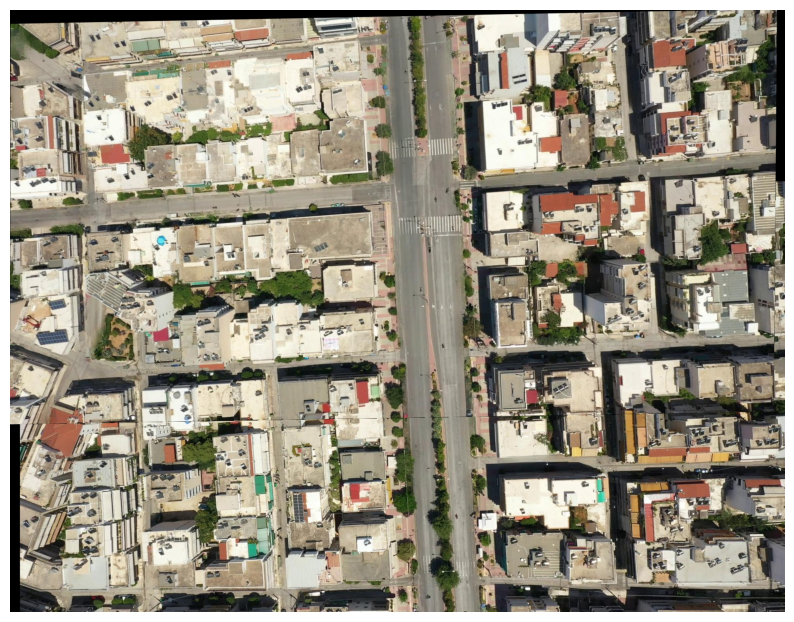

Processing image 3/7: 1400.jpg
Best rotation angle: 0° with similarity score: 2715


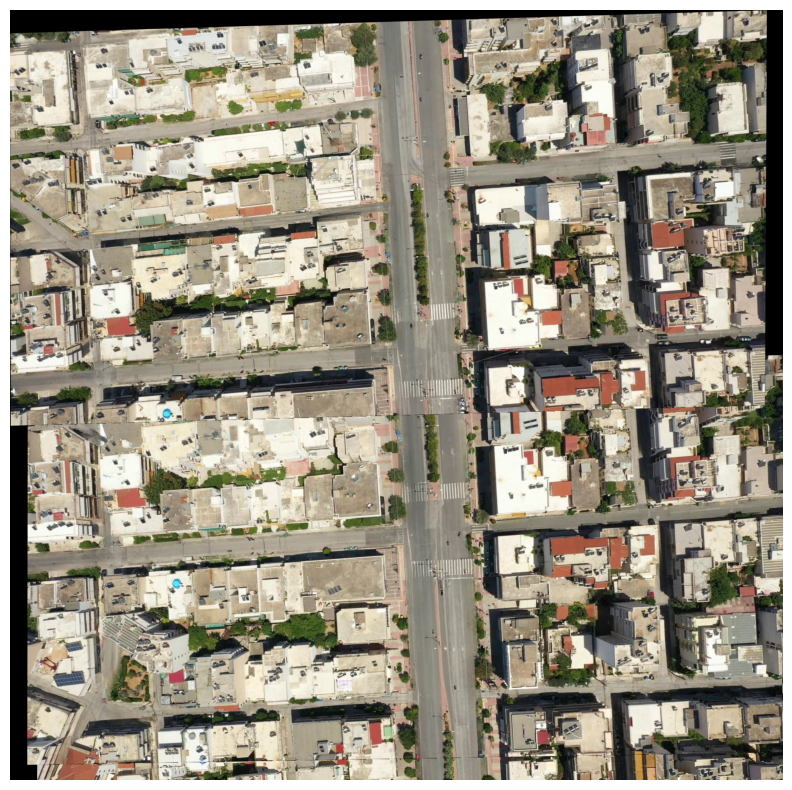

Processing image 4/7: 1600.jpg
Best rotation angle: 0° with similarity score: 2730


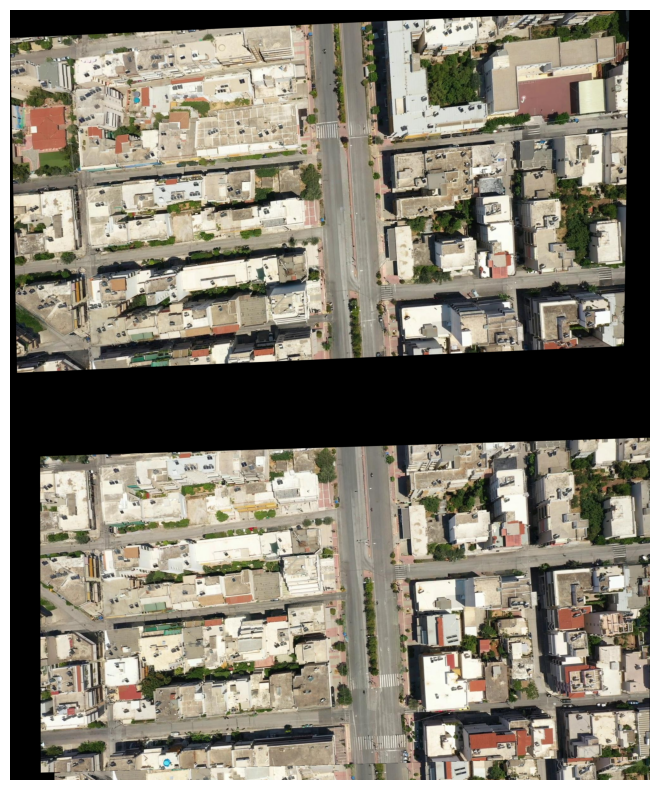

Processing image 5/7: 1800.jpg
Best rotation angle: 0° with similarity score: 2699


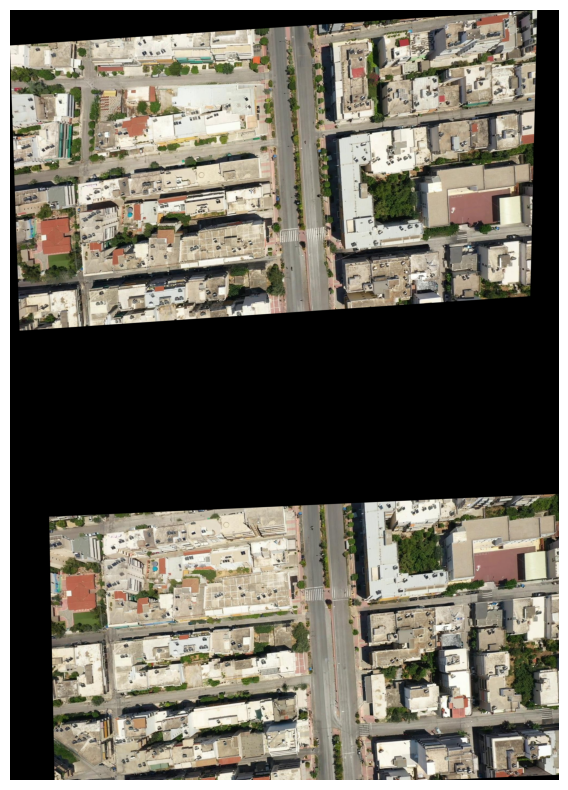

Processing image 6/7: 2000.jpg
Best rotation angle: 0° with similarity score: 2889


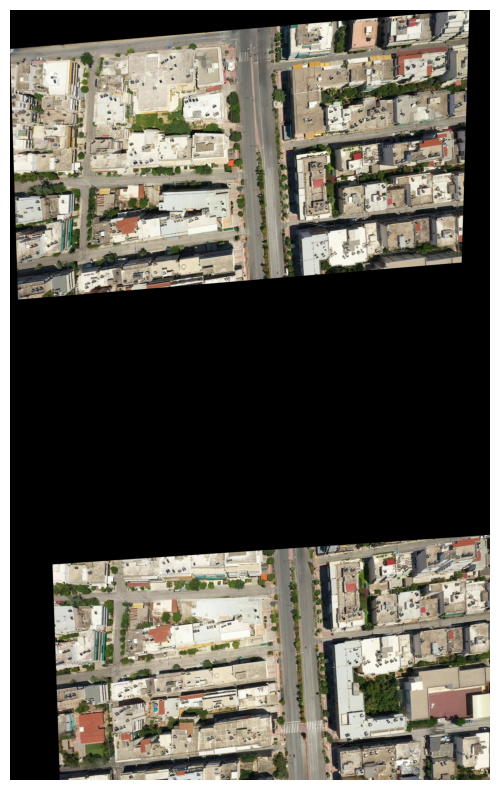

Processing image 7/7: 2200.jpg
Best rotation angle: 0° with similarity score: 2760


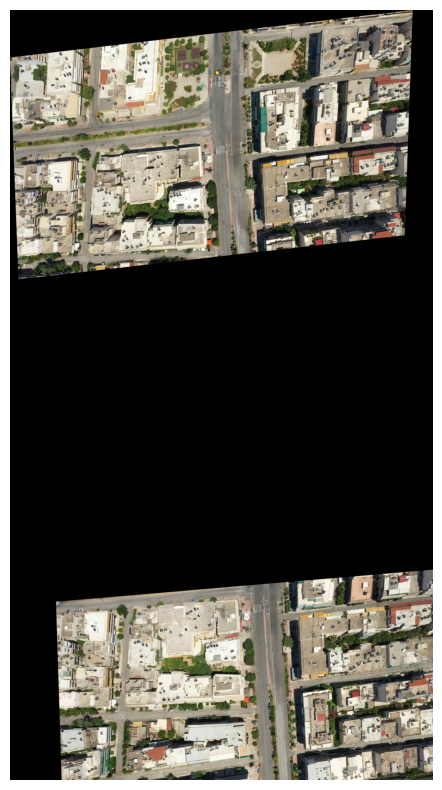

Panorama saved at /home/oussama/Documents/EPFL/PDS_LUTS/final_panorama.jpg


In [ ]:
general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'
image_paths = [
    os.path.join(general_folder_path, f'images_updated_1920x1080/{name}.jpg')
    for name in ['1000', '1200', '1400', '1600', '1800', '2000', '2200']
]
rotation_angles = range(0, 360, 45)

stitch_images(image_paths, general_folder_path, rotation_angles)


In [ ]:
from lightglue import LightGlue, DoGHardNet
from lightglue.utils import load_image, match_pair
import matplotlib.pyplot as plt
import cv2 as cv
import numpy as np
import torch
import torchvision.transforms.functional as TF
import os

general_folder_path = '/home/oussama/Documents/EPFL/PDS_LUTS/'
output_path = general_folder_path + 'panorama.jpg'

torch.cuda.empty_cache()

# Utility function to calculate image corners in homogeneous coordinates
def get_homogeneous_corners(width, height):
    return np.array([[0, 0, 1], [width, 0, 1], [width, height, 1], [0, height, 1]]).T

def warp_perspective_padded1(src, dst, transf):
    src_h, src_w = src.shape[:2]
    lin_homg_pts = np.array([[0, src_w, src_w, 0], [0, 0, src_h, src_h], [1, 1, 1, 1]])

    # Transform the source corners
    trans_lin_homg_pts = transf.dot(lin_homg_pts)
    trans_lin_homg_pts /= trans_lin_homg_pts[2, :]

    # Determine transformed bounds
    minX = np.min(trans_lin_homg_pts[0, :])
    minY = np.min(trans_lin_homg_pts[1, :])
    maxX = np.max(trans_lin_homg_pts[0, :])
    maxY = np.max(trans_lin_homg_pts[1, :])

    # Get destination size
    dst_h, dst_w = dst.shape[:2]

    # Determine padding amounts
    padding_top = max(0, -minY)
    padding_left = max(0, -minX)
    padding_bottom = max(0, maxY - dst_h)
    padding_right = max(0, maxX - dst_w)

    # Compute new padded size
    pad_sz = [
        dst_h + int(padding_top) + int(padding_bottom),
        dst_w + int(padding_left) + int(padding_right),
    ]
    dst_pad = np.zeros((pad_sz[0], pad_sz[1], 3), dtype=np.uint8)

    # Update anchorX and anchorY to reflect the top-left padding offsets
    anchorX = int(padding_left)
    anchorY = int(padding_top)

    # Update the transformation matrix to account for the padding
    transl_transf = np.eye(3)
    transl_transf[0, 2] = anchorX
    transl_transf[1, 2] = anchorY

    # Combine the translation with the original transformation
    new_transf = transl_transf.dot(transf)
    new_transf /= new_transf[2, 2]

    # Place the destination image onto the padded canvas
    dst_pad[anchorY:anchorY + dst_h, anchorX:anchorX + dst_w] = dst

    # Warp the source image into the padded canvas
    warped = cv.warpPerspective(src, new_transf, (pad_sz[1], pad_sz[0]))

    return dst_pad, warped, anchorX, anchorY

# Rotate image tensor by specified angle
def rotate_image(image, angle):
    return TF.rotate(image, angle)

# Calculate similarity score between two images
def compute_similarity_score(image1, image2, extractor, matcher):
    feats0, feats1, matches01 = match_pair(extractor, matcher, image1, image2)
    points0 = feats0['keypoints'][matches01['matches'][..., 0]]
    return points0.shape[0]

# Feature extractor and matcher initialization
extractor = DoGHardNet(max_num_keypoints=None).eval().cuda()
matcher = LightGlue(features='doghardnet').eval().cuda()

start = True

# Load images
image_path0 = general_folder_path + 'images_updated_1920x1080/2000.jpg'

# Save first image
cv.imwrite(general_folder_path + 'warped_image.jpg', cv.imread(image_path0))

image0 = load_image(image_path0)
image_path0 = general_folder_path + 'warped_image.jpg'

# Initialize dictionary for image corners
image_corners = {
    image_path0: np.array([[0, 0], [image0.shape[2] - 1, 0], 
                           [image0.shape[2] - 1, image0.shape[1] - 1], [0, image0.shape[1] - 1]])
}



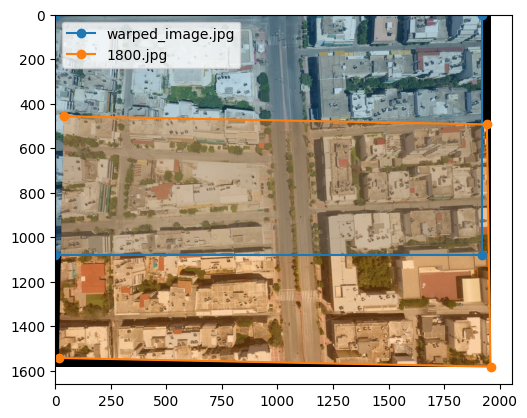

In [ ]:

image_path1 = general_folder_path + 'images_updated_1920x1080/1800.jpg'
image1 = load_image(image_path1)

# Determine best rotation angle
rotation_angles = range(0, 360, 45)
best_score, best_angle = -1, 0

for angle in rotation_angles:
    rotated_image1 = rotate_image(image1, angle)
    score = compute_similarity_score(image0, rotated_image1, extractor, matcher)
    if score > best_score:
        best_score, best_angle = score, angle
        best_rotated_image = rotated_image1

# Prepare images for final stitching
imocv0 = cv.imread(image_path0)
imocv1 = cv.cvtColor(np.array(TF.to_pil_image(best_rotated_image.cpu()).convert("RGB")), cv.COLOR_RGB2BGR)

# Extract keypoints and compute homography matrix
feats0, feats1, matches01 = match_pair(extractor, matcher, image0, best_rotated_image)
points0 = feats0['keypoints'][matches01['matches'][..., 0]].cpu().numpy()
points1 = feats1['keypoints'][matches01['matches'][..., 1]].cpu().numpy()

if points0.shape[0] >= 4:
    M, _ = cv.findHomography(points1, points0, cv.RANSAC, 5.0)
    dst_padded, warped_image, anchorX, anchorY = warp_perspective_padded1(imocv1, imocv0, M)

    # Define source corners as a numpy array and convert to float32
    new_image_corners = np.array([[0, 0], [imocv1.shape[1], 0], [imocv1.shape[1], imocv1.shape[0]], [0, imocv1.shape[0]]], dtype=np.float32)

    # Perform perspective transform with correctly typed data
    transformed_corners = cv.perspectiveTransform(np.array([new_image_corners], dtype=np.float32), M)[0]
    image_corners[image_path1] = transformed_corners + [anchorX, anchorY]

    # Overlay warped image onto padded destination
    non_zero_mask = (warped_image > 0).astype(np.uint8)
    dst_padded[non_zero_mask == 1] = warped_image[non_zero_mask == 1]

    # Update and display the panorama with corner points
    plt.imshow(cv.cvtColor(dst_padded, cv.COLOR_BGR2RGB))
    for img_path, corners in image_corners.items():
        x_coords, y_coords = corners[:, 0], corners[:, 1]
        plt.plot(x_coords, y_coords, 'o-', label=os.path.basename(img_path))
        plt.fill(x_coords, y_coords, alpha=0.3)
    plt.axis('on')
    plt.legend()
    plt.show()

    # Save final images
    cv.imwrite(output_path, dst_padded)
else:
    print("Not enough points to compute homography.")
